### Introduction


The datasets contains transactions made by credit cards in September 2013 by european cardholders. This dataset presents transactions that occurred in two days, where we have 492 frauds out of 284,807 transactions. The dataset is highly unbalanced, the positive class (frauds) account for 0.172% of all transactions.

It contains only numerical input variables which are the result of a PCA transformation.

Due to confidentiality issues, there are not provided the original features and more background information about the data.

- Features V1, V2, ... V28 are the principal components obtained with PCA;
- The only features which have not been transformed with PCA are Time and Amount. Feature Time contains the seconds elapsed between each transaction and the first transaction in the dataset. The feature Amount is the transaction Amount, this feature can be used for example-dependant cost-senstive learning.
- Feature Class is the response variable and it takes value 1 in case of fraud and 0 otherwise.

### Objective

Objective of credit card fraud detection is to identify suspicious events.Here class has two types 
Fraud and Normal and  my aim is to identify the fraud and normal transaction by tuning threshold(Threshold tuning is a common technique to determine an optimal threshold for imbalanced classification) value.

In [1]:
import numpy as np
import pandas as pd
import sklearn
import scipy
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report,accuracy_score
from pylab import rcParams

### Read the data

In [2]:
data=pd.read_csv("C:\\Users\\hp\\Downloads\\creditcard.csv\\creditcard.csv")


### Check the data

In [3]:
data.shape

(284807, 31)

In [4]:
data.columns

Index(['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10',
       'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20',
       'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount',
       'Class'],
      dtype='object')

In this data we have 284807 rows and 31 columns.

### Glimpse the data
We start by looking to the data features (first 5 rows).

In [5]:
data.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


Let's look into more details about the data.

In [6]:
data.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,284807.000000,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,...,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,284807.000000,284807.000000
mean,94813.859575,3.919560e-15,5.688174e-16,-8.769071e-15,2.782312e-15,-1.552563e-15,2.010663e-15,-1.694249e-15,-1.927028e-16,-3.137024e-15,...,1.537294e-16,7.959909e-16,5.367590e-16,4.458112e-15,1.453003e-15,1.699104e-15,-3.660161e-16,-1.206049e-16,88.349619,0.001727
std,47488.145955,1.958696e+00,1.651309e+00,1.516255e+00,1.415869e+00,1.380247e+00,1.332271e+00,1.237094e+00,1.194353e+00,1.098632e+00,...,7.345240e-01,7.257016e-01,6.244603e-01,6.056471e-01,5.212781e-01,4.822270e-01,4.036325e-01,3.300833e-01,250.120109,0.041527
min,0.000000,-5.640751e+01,-7.271573e+01,-4.832559e+01,-5.683171e+00,-1.137433e+02,-2.616051e+01,-4.355724e+01,-7.321672e+01,-1.343407e+01,...,-3.483038e+01,-1.093314e+01,-4.480774e+01,-2.836627e+00,-1.029540e+01,-2.604551e+00,-2.256568e+01,-1.543008e+01,0.000000,0.000000
25%,54201.500000,-9.203734e-01,-5.985499e-01,-8.903648e-01,-8.486401e-01,-6.915971e-01,-7.682956e-01,-5.540759e-01,-2.086297e-01,-6.430976e-01,...,-2.283949e-01,-5.423504e-01,-1.618463e-01,-3.545861e-01,-3.171451e-01,-3.269839e-01,-7.083953e-02,-5.295979e-02,5.600000,0.000000
50%,84692.000000,1.810880e-02,6.548556e-02,1.798463e-01,-1.984653e-02,-5.433583e-02,-2.741871e-01,4.010308e-02,2.235804e-02,-5.142873e-02,...,-2.945017e-02,6.781943e-03,-1.119293e-02,4.097606e-02,1.659350e-02,-5.213911e-02,1.342146e-03,1.124383e-02,22.000000,0.000000
75%,139320.500000,1.315642e+00,8.037239e-01,1.027196e+00,7.433413e-01,6.119264e-01,3.985649e-01,5.704361e-01,3.273459e-01,5.971390e-01,...,1.863772e-01,5.285536e-01,1.476421e-01,4.395266e-01,3.507156e-01,2.409522e-01,9.104512e-02,7.827995e-02,77.165000,0.000000
max,172792.000000,2.454930e+00,2.205773e+01,9.382558e+00,1.687534e+01,3.480167e+01,7.330163e+01,1.205895e+02,2.000721e+01,1.559499e+01,...,2.720284e+01,1.050309e+01,2.252841e+01,4.584549e+00,7.519589e+00,3.517346e+00,3.161220e+01,3.384781e+01,25691.160000,1.000000


#### Check missing data
Let's check if there is any missing data.

In [7]:
data.isnull().sum()

Time      0
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
Amount    0
Class     0
dtype: int64

In [8]:
## OR
data.isna().any()

Time      False
V1        False
V2        False
V3        False
V4        False
V5        False
V6        False
V7        False
V8        False
V9        False
V10       False
V11       False
V12       False
V13       False
V14       False
V15       False
V16       False
V17       False
V18       False
V19       False
V20       False
V21       False
V22       False
V23       False
V24       False
V25       False
V26       False
V27       False
V28       False
Amount    False
Class     False
dtype: bool

In [9]:
null_columns=pd.DataFrame({'columns':data.isna().sum().index,
                           'No. of null values':data.isna().sum().values,
                           'percentage':data.isna().sum().values/data.shape[0]})

In [10]:
null_columns

,columns,No. of null values,percentage
0,Time,0,0.0
1,V1,0,0.0
2,V2,0,0.0
3,V3,0,0.0
4,V4,0,0.0
5,V5,0,0.0
6,V6,0,0.0
7,V7,0,0.0
8,V8,0,0.0
9,V9,0,0.0


In this dataset we have no missing data.

#### Check data is balance or not

Text(0, 0.5, 'Frequency')

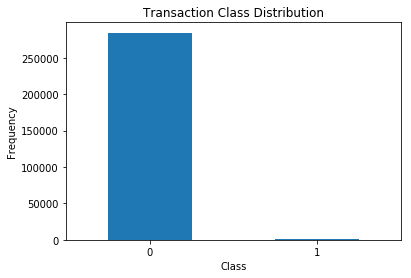

In [11]:
count_classes = pd.value_counts(data['Class'], sort = True)
count_classes.plot(kind = 'bar', rot=0)
plt.title("Transaction Class Distribution")
# plt.xticks(range(2), LABELS)
plt.xlabel("Class")
plt.ylabel("Frequency")

In [12]:
## Get the Fraud and the normal dataset 
fraud = data[data['Class']==1]
normal = data[data['Class']==0]
print(fraud.shape,normal.shape)

(492, 31) (284315, 31)


#### Percentage of total not fraud transaction

In [13]:
count=0
notfraud=data["Class"]
for i in range(len(notfraud)):
    if notfraud[i]==0:
        count=count+1
count
per_nf=(count/len(notfraud))*100
print("Percentage of total not fraud transaction in dataset",per_nf)

Percentage of total not fraud transaction in dataset 99.82725143693798


In [14]:
count=0
fraud=data["Class"]
for i in range(len(fraud)):
    if fraud[i]==1:
        count=count+1
count
per_nf=(count/len(notfraud))*100
print("Percentage of total fraud transaction in dataset",per_nf)

Percentage of total fraud transaction in dataset 0.1727485630620034


#### As per the graph we can say the ratio of normal transaction are higher than fraud transactions.

Text(0.5, 1.0, 'Time vs amount')

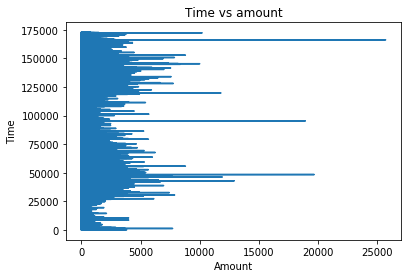

In [15]:
plt.plot(data["Amount"],data['Time'])
plt.xlabel("Amount")
plt.ylabel('Time')
plt.title("Time vs amount")

##### From above graph we try to find the relation between Time and Amount.

C:\Users\hp\Anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


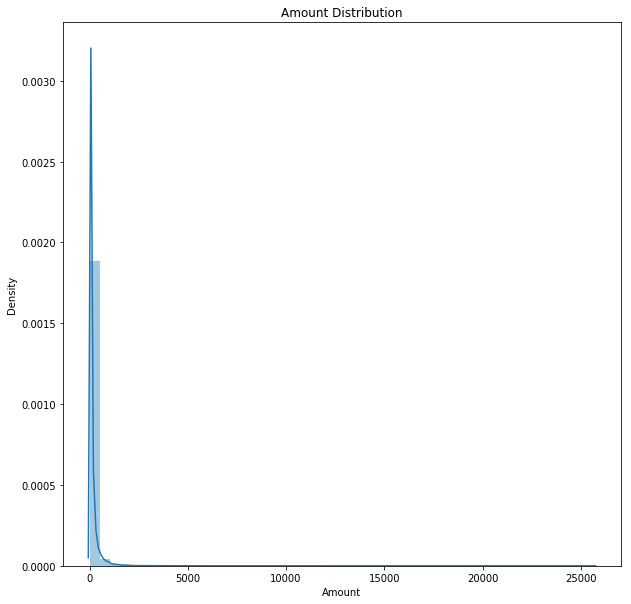

In [16]:
plt.figure(figsize=(10,10),)
plt.title('Amount Distribution')
sns.distplot(data["Amount"])

##### From this amount distribution we can say that the number of high amount transactions are very low.So there is a high probability for huge transactions to be fraud.  

#### Outlier

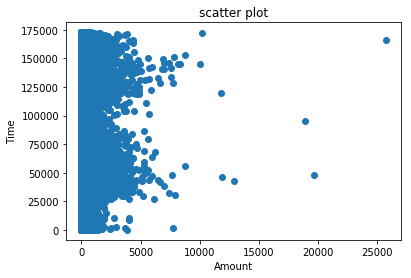

In [17]:
plt.scatter(data["Amount"],data['Time'])
plt.xlabel("Amount")
plt.ylabel('Time')
plt.title("scatter plot")
plt.show()

#### In above scatter plot some transaction seems to be outlier but it may be fraud transaction.so we keep this transaction for prediction. 

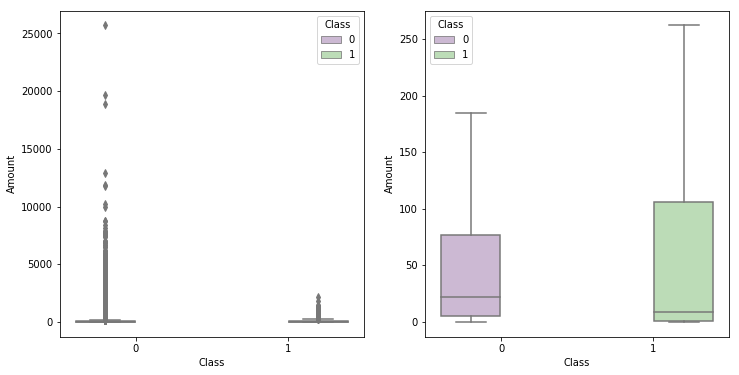

In [18]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12,6))
s = sns.boxplot(ax = ax1, x=data["Class"], y=data["Amount"], hue="Class",data=data, palette="PRGn",showfliers=True)
s = sns.boxplot(ax = ax2, x=data["Class"], y=data["Amount"], hue="Class",data=data, palette="PRGn",showfliers=False)
plt.show();

In [19]:
## Get the Fraud and the normal dataset 
fraud = data[data['Class']==1]
normal = data[data['Class']==0]
outlier_fraction = len(fraud)/float(len(normal))

In [20]:
fraud[['Amount']].describe()

,Amount
count,492.000000
mean,122.211321
std,256.683288
min,0.000000
25%,1.000000
50%,9.250000
75%,105.890000
max,2125.870000


In [21]:
normal[['Amount']].describe()

,Amount
count,284315.000000
mean,88.291022
std,250.105092
min,0.000000
25%,5.650000
50%,22.000000
75%,77.050000
max,25691.160000


#### The normal transaction have a smaller mean value, larger Q1, smaller Q3 ; fraudulent transactions have a smaller Q1 and larger mean, larger Q3 .If we see the left side graph there 0 have higher outlier than 1.

### Correlation matrix

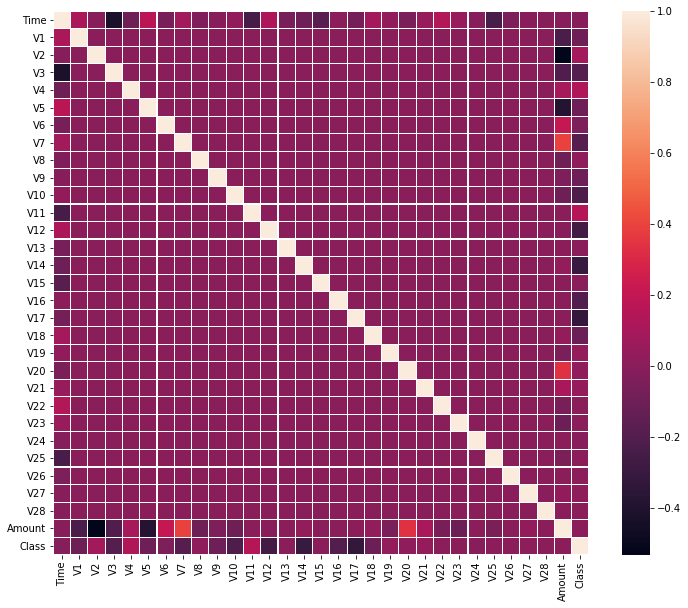

In [22]:
plt.figure(figsize=(12,10))
sns.heatmap(data.corr(),linewidths=.1)

From above correlation matrix class is inversly correlated with v3,v7,v10,v14,v17 and directly correlated with remaing variable.
Amount is inversly correlated with v1,v2,v3,v5 and highly correlated with v7,v20.
Time is inversly correlated with v3,v11,v15,v25 and irectly correlated with remaing variable.


### Predictive models

Define predictors and target values
Let's define the predictor features and the target features. Categorical features, if any, are also defined. In our case, there are no categorical feature.

Split data into train and test

In [23]:
data.head()
X=data.drop(["Class"],axis=1)
y=data["Class"]
# split data into train and test
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test=train_test_split(X,y,test_size=0.2,random_state=10)

### 1.Logistic Regression

In [24]:
from sklearn.linear_model import LogisticRegression
model= LogisticRegression()

In [25]:
model.fit(x_train,y_train)

C:\Users\hp\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [26]:
model.score(x_test,y_test)## Accuracy

0.9988588883817282

#### Here Accuracy of Logistic Regression is too high(0.9988) but it is not useful because here our data is highly unbalanced.For Unbalanced data f-score is useful.

In [27]:
pred=model.predict(x_test)

In [28]:
from sklearn import metrics

In [29]:
print(metrics.confusion_matrix(y_test,pred))

[[56839    29]
 [   36    58]]


In [30]:
print(metrics.classification_report(y_test,pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56868
           1       0.67      0.62      0.64        94

    accuracy                           1.00     56962
   macro avg       0.83      0.81      0.82     56962
weighted avg       1.00      1.00      1.00     56962



From above table precision is 0.67 and f1-score is 0.64 .Precision is very low in Logistic Regression.
Precision=0.67,means out of 100 fraud  only 67 times it predict fraud .Here my aim is to increase
precision .

In [31]:
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
roc_auc_score(y_test,pred)

0.8082556618612121

In [32]:
def plot_roc_curve(fpr,tpr):
    plt.plot(fpr,tpr,color='green',label='ROC', marker='o')
    plt.plot([0,1],[0,1],color='darkblue',linestyle='--')
    plt.xlabel('FPR')
    plt.ylabel("TPR")
    plt.title("ROC CURVE")
    plt.legend()
    plt.show()

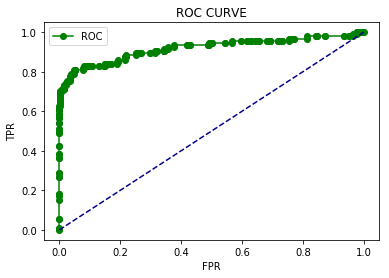

In [33]:
probs=model.predict_proba(x_test)
probs=probs[:,1]
roc_auc_score(y_test,pred)
fpr,tpr,thresholds=roc_curve(y_test,probs)
plot_roc_curve(fpr,tpr)

#### Here I want to check in which threshold this data gives high f1-score and precision.

In [34]:
from sklearn import metrics
from sklearn.metrics import precision_recall_curve 
# Create the Precision-Recall curve
precision, recall, threshold = metrics.precision_recall_curve(y_test,probs)

In [35]:
import plotly.express as px
fig=px.line(x=recall[:-1],y=precision[:-1],hover_name=threshold)
fig.update_xaxes(title="Recall")
fig.update_yaxes(title="Precision")
fig

In [36]:
import plotly.graph_objects as go
fig = go.Figure()
fig.add_trace(go.Scatter(name="precision",x=threshold,y=precision[:-1]))
fig.add_trace(go.Scatter(name="recall",x=threshold,y=recall[:-1]))
fig.update_xaxes(title="threshold")
fig.update_yaxes(title="proportion")
fig

#### From above two graph it is clear that on threshold=0.65 it will give high precision and f1-score.Now if we compare f1-score of  threshold=0.65 and f1-score of  threshold=0.50,f1-score of  threshold=0.65 is higher than f1-score of  threshold=0.50.But still Logistic Regression is not giving high f1-score.

In [37]:
x=(model.predict_proba(x_test)>=0.65).astype(int)
metrics.confusion_matrix(y_test,x[:,1])

array([[56848,    20],
       [   37,    57]], dtype=int64)

In [38]:
print(metrics.classification_report(y_test,x[:,1]))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56868
           1       0.74      0.61      0.67        94

    accuracy                           1.00     56962
   macro avg       0.87      0.80      0.83     56962
weighted avg       1.00      1.00      1.00     56962



### 2.Random Forest

In [39]:
from sklearn.ensemble import RandomForestClassifier

In [40]:
model=RandomForestClassifier( )

In [41]:
model.fit(x_train,y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [42]:
pred=model.predict(x_test)

In [43]:
from sklearn import metrics
print(metrics.confusion_matrix(y_test,pred))
print(metrics.classification_report(y_test,pred))

[[56866     2]
 [   16    78]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56868
           1       0.97      0.83      0.90        94

    accuracy                           1.00     56962
   macro avg       0.99      0.91      0.95     56962
weighted avg       1.00      1.00      1.00     56962



In [44]:
from sklearn.metrics import roc_auc_score
roc_auc_score(y_test,pred)

0.9148760324394379

In [45]:
probs=model.predict_proba(x_test)
probs

array([[1., 0.],
       [1., 0.],
       [1., 0.],
       ...,
       [1., 0.],
       [1., 0.],
       [1., 0.]])

In [46]:
probs=probs[:,1]

In [47]:
roc_auc_score(y_test,pred)
fpr,tpr,thresholds=roc_curve(y_test,probs)

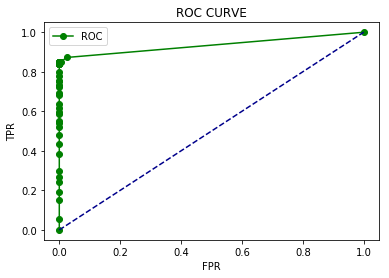

In [48]:
plot_roc_curve(fpr,tpr)

In [49]:
from sklearn import metrics
from sklearn.metrics import precision_recall_curve 
# Create the Precision-Recall curve
precision, recall, threshold = metrics.precision_recall_curve(y_test,probs)

In [50]:
import plotly.express as px
fig=px.line(x=recall[:-1],y=precision[:-1],hover_name=threshold)
fig.update_xaxes(title="Recall")
fig.update_yaxes(title="Precision")
fig

In [51]:
import plotly.graph_objects as go
fig = go.Figure()
fig.add_trace(go.Scatter(name="precision",x=threshold,y=precision[:-1]))
fig.add_trace(go.Scatter(name="recall",x=threshold,y=recall[:-1]))
fig.update_xaxes(title="threshold")
fig.update_yaxes(title="proportion")
fig

In [52]:
x=(model.predict_proba(x_test)>=0.4).astype(int)
metrics.confusion_matrix(y_test,x[:,1])

array([[56865,     3],
       [   15,    79]], dtype=int64)

In [53]:
print(metrics.classification_report(y_test,x[:,1]))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56868
           1       0.96      0.84      0.90        94

    accuracy                           1.00     56962
   macro avg       0.98      0.92      0.95     56962
weighted avg       1.00      1.00      1.00     56962



## Conclusion

We investigated the data, checking for data unbalancing, visualizing the features and understanding
the relationship between different features. We then investigated two predictive models.
The data was split in 2 parts, a train set and a test set. For the both models, we used the
train and test set.

We started with Logistic Regression, for which we obtained an AUC score of 0.80,f1-score 0.64 when predicting 
the target for the test set.

We followed with an Random Forest model, with higher AUC score (0.91) and f1-score 0.90 for prediction of the test set
target values.






## Reference

https://towardsdatascience.com/optimal-threshold-for-imbalanced-classification-5884e870c293